# KNN

In [73]:
import pandas as pd
import numpy as np
from sklearn import datasets
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

In [88]:
data = pd.read_csv('data.csv')

In [75]:
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [76]:
data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [77]:
data.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [89]:
data['diagnosis'] = data['diagnosis'].apply(lambda x: 1 if x=='M' else 0)

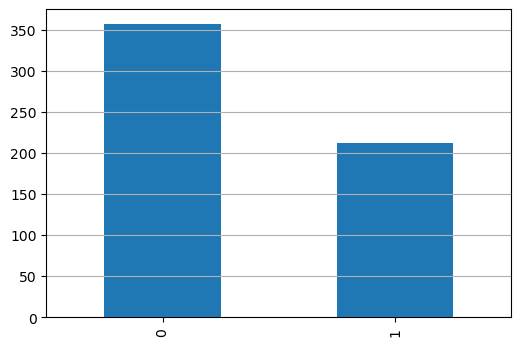

In [80]:
data['diagnosis'].value_counts().plot.bar(figsize=(6, 4))
plt.grid(axis='y')

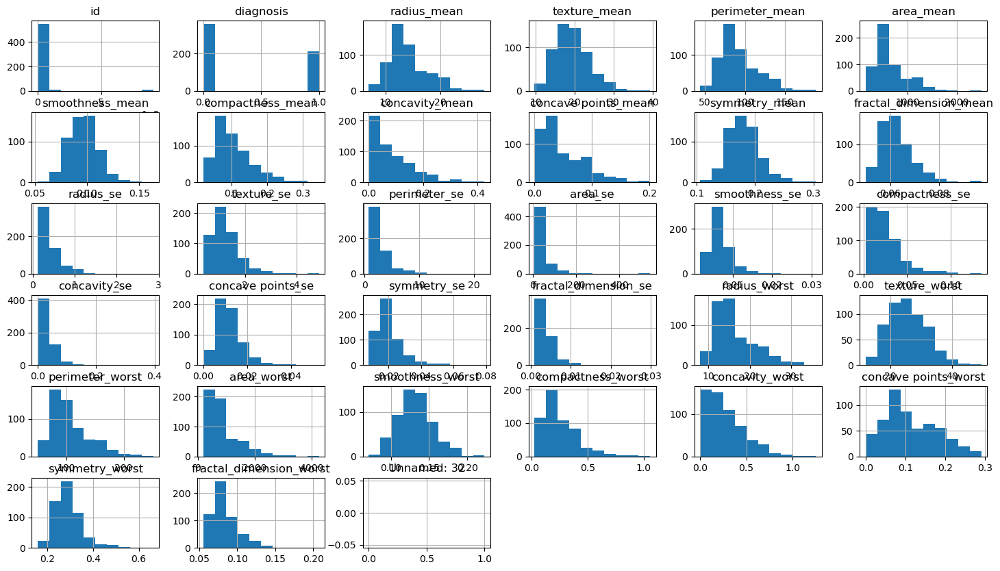

In [81]:
data.hist(figsize=(18, 10));

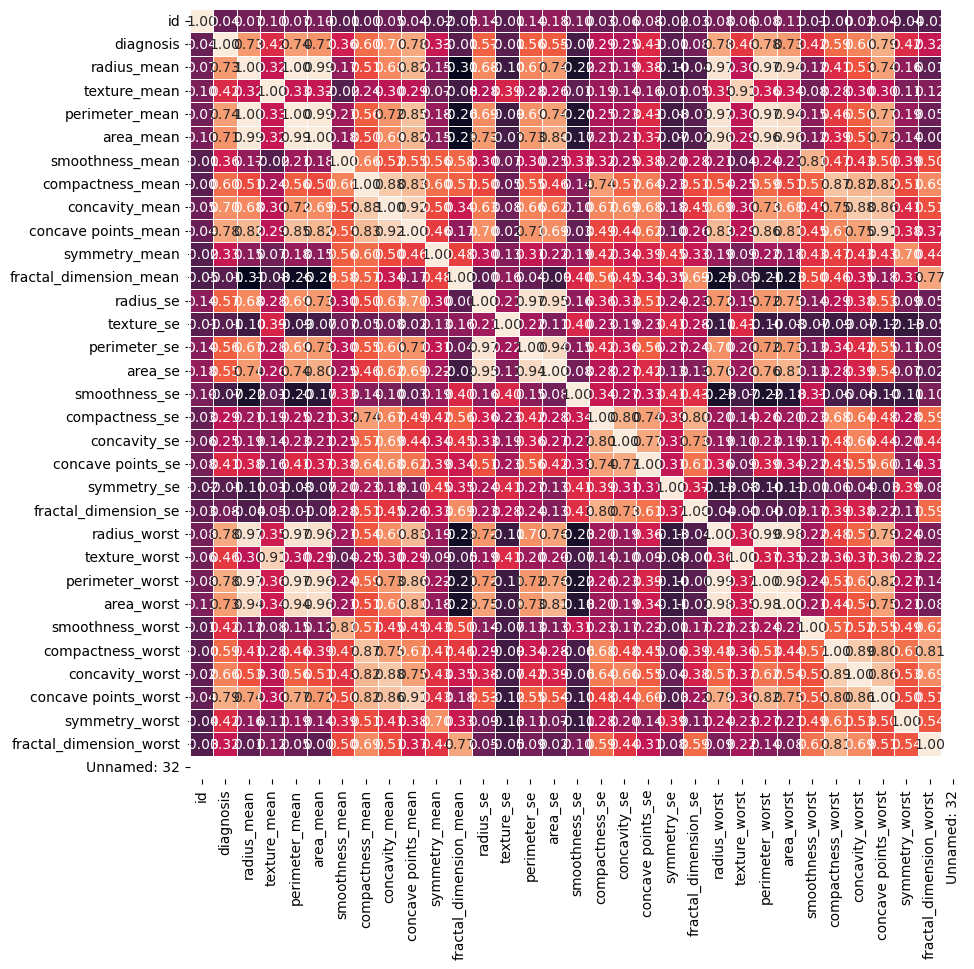

In [82]:
#correlation map
plt.figure(figsize=(10, 10))
sns.heatmap(data.corr(), annot=True, cbar=False, linewidths=.5, fmt= '.2f')
plt.show()

In [83]:
sns.pairplot(data, hue='diagnosis');

In [ ]:
Выводы по признакам:
    1 Удалим технические параметры id, Unnamed: 32
    2 Геометрические параметры radius, perimeter, area вычисляются друг из друга и имеют полную корреляцию. 
    Для дальнейшей работы возьмем 1 из параметров radius.
    3 По correlation map удалим некоторые другие параметры имеющие значительную корреляцию

In [91]:
data = data.drop(columns=['id', 'Unnamed: 32',
                        'perimeter_mean', 'area_mean', 'perimeter_se', 'area_se', 
                        'radius_worst', 'perimeter_worst', 'area_worst', 'texture_worst', 'concavity_worst', 
                        'compactness_worst', 'smoothness_worst',
                        'concave points_mean', 'concavity_mean'])

# Итоговые признаки:

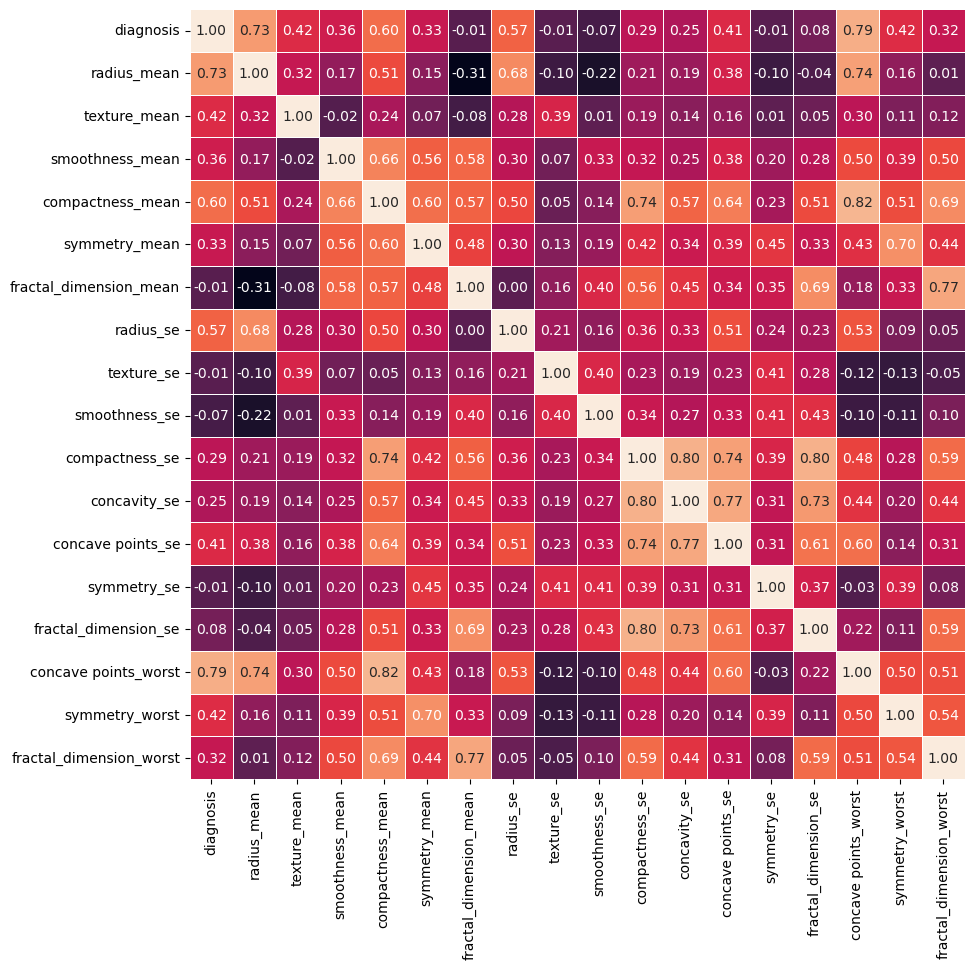

In [92]:
plt.figure(figsize=(10, 10))
sns.heatmap(data.corr(), annot=True, cbar=False, linewidths=.5, fmt= '.2f')
plt.show()

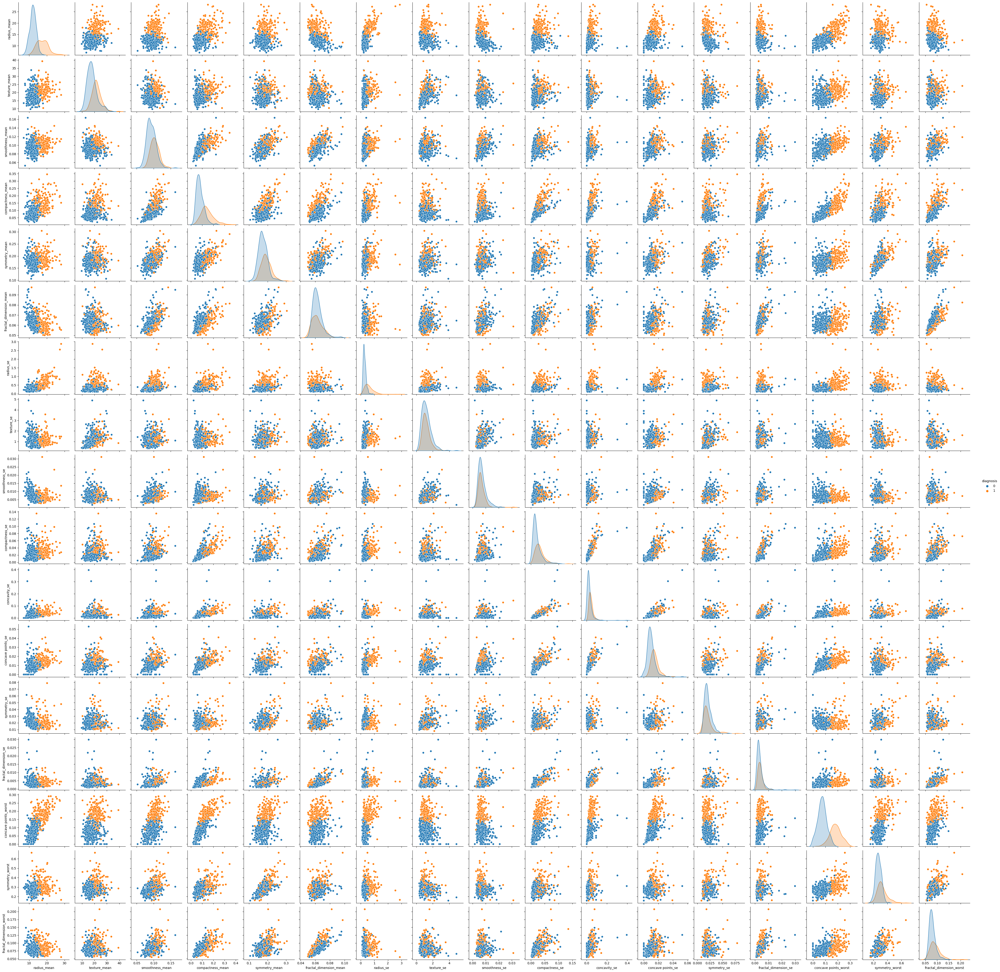

In [93]:
sns.pairplot(data, hue='diagnosis');

# Часть 2. Моделирование при помощи kNN

In [94]:
y = data['diagnosis']
X = data.drop(columns=['diagnosis'])

X_train, X_test, y_train, y_test = train_test_split(
    data.drop(['diagnosis'], axis=1), data['diagnosis'], test_size=0.30, random_state=42, stratify=data['diagnosis']
)

In [95]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape 

((398, 17), (171, 17), (398,), (171,))

In [96]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [97]:
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

In [106]:
neighbors = range(1, 50)
accuracy_score_train = []
accuracy_score_test = []

precision_score_train = []
precision_score_test = []

recall_score_train = []
recall_score_test = []

f1_score_train = []
f1_score_test = []
for k in neighbors:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train_scaled, y_train)
    accuracy_score_train.append(accuracy_score(knn.predict(X_train_scaled), y_train))
    accuracy_score_test.append(accuracy_score(knn.predict(X_test_scaled), y_test))
    
    precision_score_train.append(precision_score(knn.predict(X_train_scaled), y_train))
    precision_score_test.append(precision_score(knn.predict(X_test_scaled), y_test))
    
    recall_score_train.append(recall_score(knn.predict(X_train_scaled), y_train))
    recall_score_test.append(recall_score(knn.predict(X_test_scaled), y_test))
    
    f1_score_train.append(f1_score(knn.predict(X_train_scaled), y_train))
    f1_score_test.append(f1_score(knn.predict(X_test_scaled), y_test))



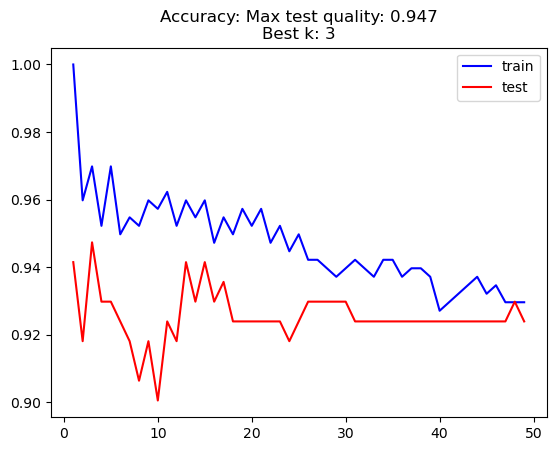

In [111]:
plt.plot(neighbors, accuracy_score_train, color='blue', label='train')
plt.plot(neighbors, accuracy_score_test, color='red', label='test')
plt.title("Accuracy: Max test quality: {:.3f}\nBest k: {}".format(max(accuracy_score_test), np.argmax(accuracy_score_test)+1))
plt.legend();

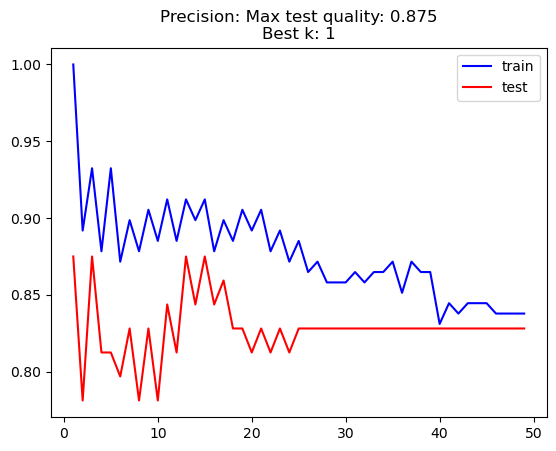

In [112]:
plt.plot(neighbors, precision_score_train, color='blue', label='train')
plt.plot(neighbors, precision_score_test, color='red', label='test')
plt.title("Precision: Max test quality: {:.3f}\nBest k: {}".format(max(precision_score_test), np.argmax(precision_score_test)+1))
plt.legend();

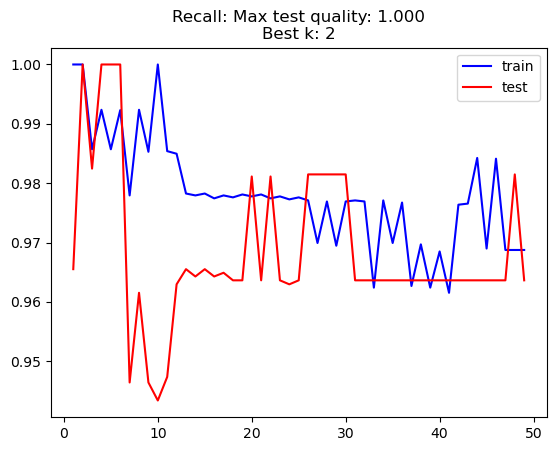

In [113]:
plt.plot(neighbors, recall_score_train, color='blue', label='train')
plt.plot(neighbors, recall_score_test, color='red', label='test')
plt.title("Recall: Max test quality: {:.3f}\nBest k: {}".format(max(recall_score_test), np.argmax(recall_score_test)+1))
plt.legend();

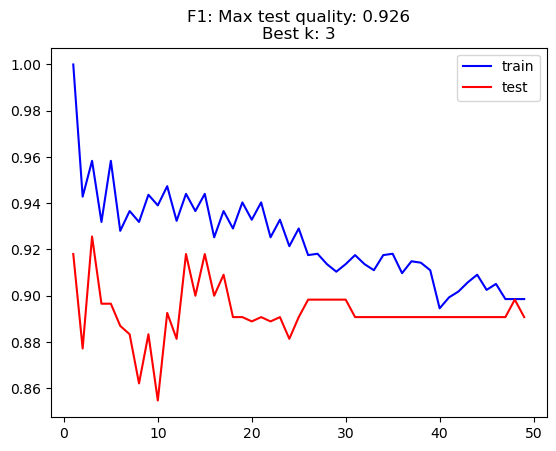

In [114]:
plt.plot(neighbors, f1_score_train, color='blue', label='train')
plt.plot(neighbors, f1_score_test, color='red', label='test')
plt.title("F1: Max test quality: {:.3f}\nBest k: {}".format(max(f1_score_test), np.argmax(f1_score_test)+1))
plt.legend();

In [ ]:
Исходя из предметной области будем ориентироваться на Recall

In [115]:
%%time
from sklearn.model_selection import GridSearchCV

param_grid = {
        'n_neighbors': range(1, 50),
        'p': range(1, 4)
}

knn = KNeighborsClassifier()

grid_search = GridSearchCV(knn, param_grid, cv=5, scoring='recall', verbose=1)
grid_search.fit(X_train_scaled, y_train)

print("Best CV score: {:.3f}, best CV k: {}".format(
    grid_search.best_score_, grid_search.best_estimator_.n_neighbors)
) 


test_predictions = grid_search.best_estimator_.predict(X_test_scaled)
print("Resulting test score: {:.3f}".format(recall_score(test_predictions, y_test)))

Fitting 5 folds for each of 147 candidates, totalling 735 fits
Best CV score: 0.899, best CV k: 3
Resulting test score: 0.982
CPU times: user 1min 1s, sys: 1.63 s, total: 1min 3s
Wall time: 8.64 s
